<a href="https://colab.research.google.com/github/ykitaguchi77/GravCont_classification_colab/blob/master/Eye_crop_bilateral_perioculra.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#顔の画像から目を検出して切り抜くスクリプト
・Haarcascade_eyeを使用<br>
・目が検出できないものはskipする<br>
・横幅を1/4倍、縦幅を上下に1/4倍追加して画像を切り取る（目の全幅、眉毛が含まれるように）

・切り取った画像を500px*500pxにresizeする<br>
・フォルダ内の画像を一括変換して別フォルダに保存

In [63]:
import numpy as np
import matplotlib.pyplot as plt
import time
import os
import shutil
import copy
import pandas as pd
import csv
from random import randint
from time import sleep
import numpy as np
import sys


import glob
import random
from PIL import Image
%matplotlib inline

#サポートパッチのインポート
from google.colab.patches import cv2_imshow
import cv2

plt.ion()   # interactive mode

#Google colabをマウント

In [64]:
'''
・dlibを用いて目を切り抜く
・横幅を2倍、縦幅を上に1倍追加/下に0.5倍追加して画像を切り取る（目の全幅、眉毛が含まれるように）
'''

from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#残り時間確認
!cat /proc/uptime | awk '{printf("残り時間 : %.2f", 12-$1/60/60)}'


残り時間 : 11.68

In [65]:
#元画像
in_path = '/content/drive/MyDrive/Deep_learning/Face_Images/IMG_3110.JPG'

#保存先フォルダ
out_path = '/content/drive/My Drive/Deep_learning/eyelid_images/IMG_3110_eye.JPG'


#Haarcascadeを指定

In [66]:
# カスケードファイルのパス
eye_cascade_path = '/content/drive/My Drive/Deep_learning/haarcascade_eye.xml'

# カスケード分類器の特徴量取得
eye_cascade = cv2.CascadeClassifier(eye_cascade_path)

In [67]:
#アスペクト比を維持したまま横を400pixelに縮小する
def scale_to_width(img, width):
    scale = width / img.shape[1]
    return cv2.resize(img, dsize=None, fx=scale, fy=scale)

#図を表示する
def show_image(img):
    #img = cv2.imread(out_path)
    dst = scale_to_width(img, 400)
    cv2_imshow(dst)

def my_round(val, digit=0):
    p = 10 ** digit
    return int((val * p * 2 + 1) // 2 / p)

In [75]:
def crop_bilateral(in_path, size):
    img_resized_list,side_list = [],[]

    img = cv2.imread(in_path) 
    img2 = img.copy()

    # 画像グレースケール化
    grayscale_img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    #300pix以上のもので目に見えるものを抽出
    eye_list = eye_cascade.detectMultiScale(grayscale_img, minSize=(300, 300))
    print('image path = ',in_path)

    # 眼検出判定
    if len(eye_list) >= 1:
        print('目が' + str(len(eye_list)) +'個検出されました')
        pass
    else:
        print("no eye detected")
        sys.exit()

    print(eye_list)

    #画像の切り抜きと保存（連番にする）

    for (ex, ey, ew, eh) in eye_list:
        print("[ex,ey] = %d,%d [ew,eh] = %d,%d" %(ex, ey, ew, eh))
        
        try:
          cv2.rectangle(img2, (ex, ey), (ex + ew, ey + eh), (0, 255, 0), 2)

          #切り抜き範囲が元画像をはみ出る場合は黒画像で埋める
          top = max(0, ey-int(eh/4))
          bottom = min(grayscale_img.shape[0], int(ey + eh*5/4))
          left = max(0,int(ex-int(ew/4)))
          right = min(grayscale_img.shape[1], int(ex + ew*5/4))

          #print(f"top:{top}, bottom:{bottom}, left:{left}, right:{right}")

          img_cropped = img[top: bottom,left:right]
          height, width = img_cropped.shape[:2]


          #print(f"height:{height}, width:{width}")
          if width==height:
              img_background =img_cropped
          elif width>height:
              img_background = np.zeros((width,width,3), dtype = np.uint8)
              img_background[0:width, my_round((width-height)/2) :int(((width+height)/2)+height)]=img_cropped
          elif width<height:
              img_background = np.zeros((height,height,3), dtype = np.uint8)
              img_background[0:height, my_round((height-width)/2) :int(((height-width)/2)+width)]=img_cropped
          
          img_resized = cv2.resize(img_background,(size,size)) #1辺を指定したpixにresize 

          show_image(img_resized)

        except:
          print('crop error')

        if ex <= grayscale_img.shape[1]/2:
            side = 0 #600ピクセル目より左にあるのは右眼
        else:
            side = 1 #600ピクセル目より右にあるのは左眼

        try:
            img_resized_list.append(img_resized)
            side_list.append(side)
        except:
            pass
        
    return(img_resized_list, side_list)


image path =  /content/drive/MyDrive/Deep_learning/Face_Images/IMG_3110.JPG
目が2個検出されました
[[1247 1189  436  436]
 [ 596 1278  424  424]]
[ex,ey] = 1247,1189 [ew,eh] = 436,436


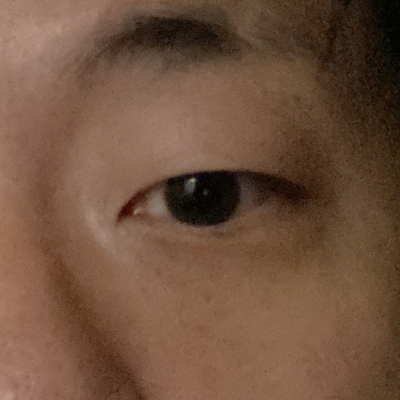

[ex,ey] = 596,1278 [ew,eh] = 424,424


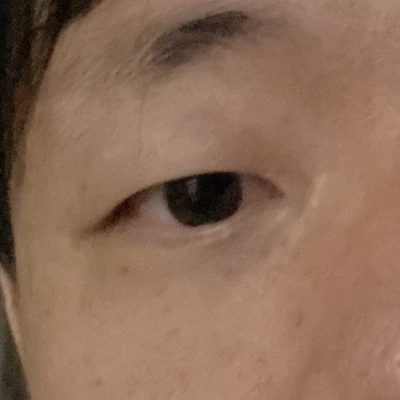

In [76]:
img_resized_list, side_list = crop_bilateral(in_path, 500)

#**ここからがメイン**

In [69]:
orig_folder = "/content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset" #olympiaのデータセット
path_list = glob.glob(orig_folder+"/*")
path = path_list[0]
path


'/content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/19.JPG'

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/19.JPG
目が2個検出されました
[[ 177  627  696  696]
 [1584  618  708  708]]
[ex,ey] = 177,627 [ew,eh] = 696,696


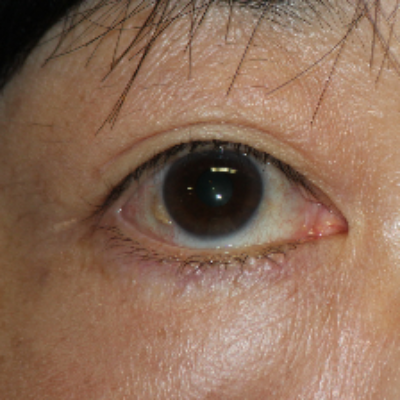

[ex,ey] = 1584,618 [ew,eh] = 708,708


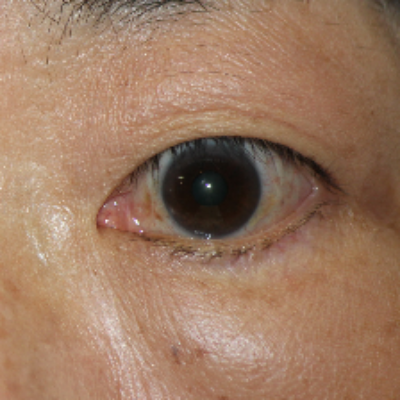

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/20.JPG
目が2個検出されました
[[1570  568  815  815]
 [ 152  561  785  785]]
[ex,ey] = 1570,568 [ew,eh] = 815,815


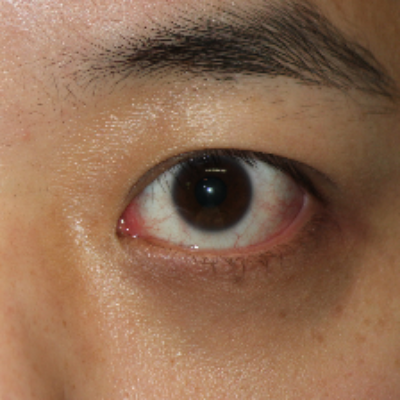

[ex,ey] = 152,561 [ew,eh] = 785,785


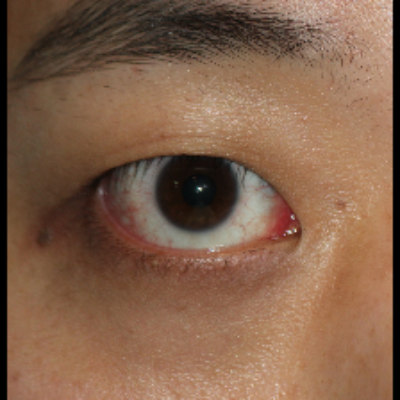

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/21.JPG
目が2個検出されました
[[1636  610  757  757]
 [ 219  627  723  723]]
[ex,ey] = 1636,610 [ew,eh] = 757,757


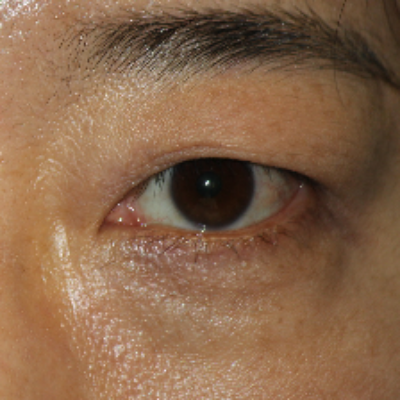

[ex,ey] = 219,627 [ew,eh] = 723,723


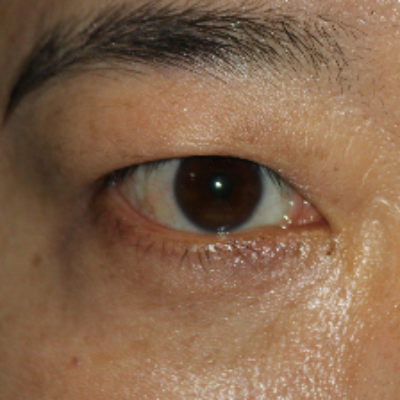

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/22.JPG
目が2個検出されました
[[ 135  463  888  888]
 [1624  494  858  858]]
[ex,ey] = 135,463 [ew,eh] = 888,888
crop error
[ex,ey] = 1624,494 [ew,eh] = 858,858


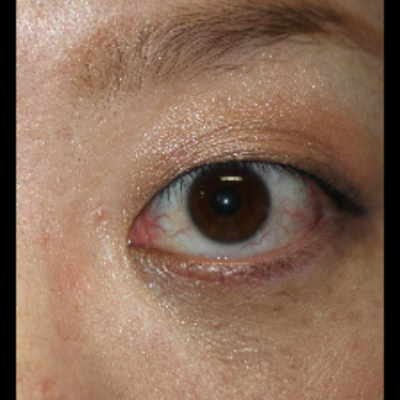

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/23.JPG
目が2個検出されました
[[ 175  499  695  695]
 [1676  519  772  772]]
[ex,ey] = 175,499 [ew,eh] = 695,695


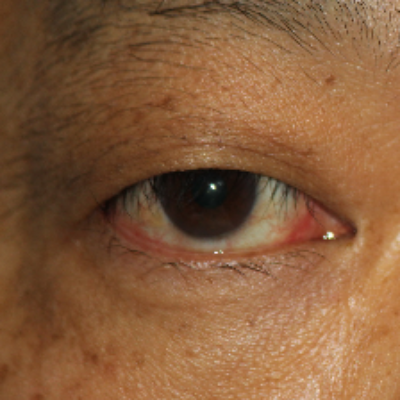

[ex,ey] = 1676,519 [ew,eh] = 772,772
crop error
image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/24.JPG
目が2個検出されました
[[ 200  526  748  748]
 [1533  554  730  730]]
[ex,ey] = 200,526 [ew,eh] = 748,748


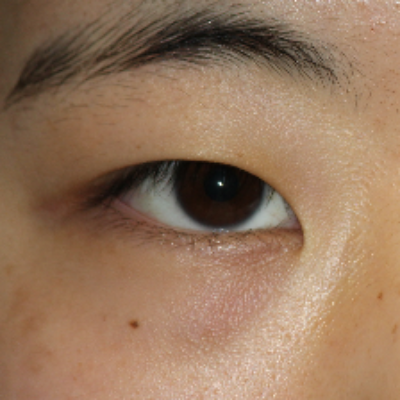

[ex,ey] = 1533,554 [ew,eh] = 730,730


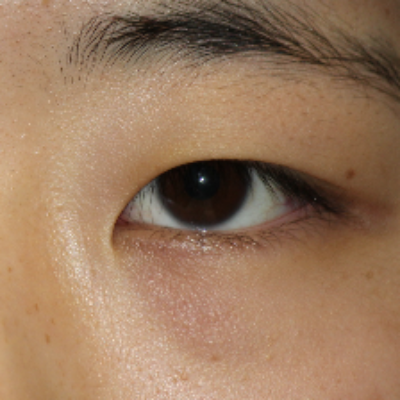

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/25.JPG
目が2個検出されました
[[ 258  477  681  681]
 [1672  434  777  777]]
[ex,ey] = 258,477 [ew,eh] = 681,681


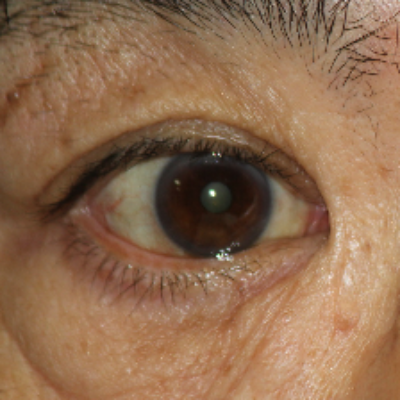

[ex,ey] = 1672,434 [ew,eh] = 777,777
crop error
image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/26.JPG
目が1個検出されました
[[1824  588  594  594]]
[ex,ey] = 1824,588 [ew,eh] = 594,594


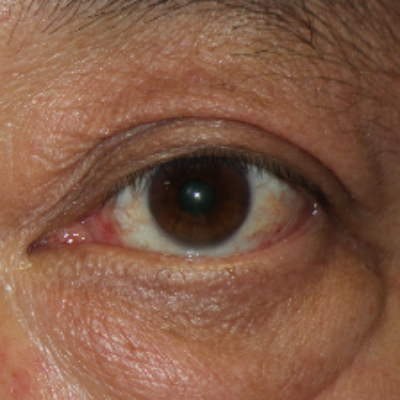

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/27.JPG
目が2個検出されました
[[ 234  585  769  769]
 [1558  540  771  771]]
[ex,ey] = 234,585 [ew,eh] = 769,769


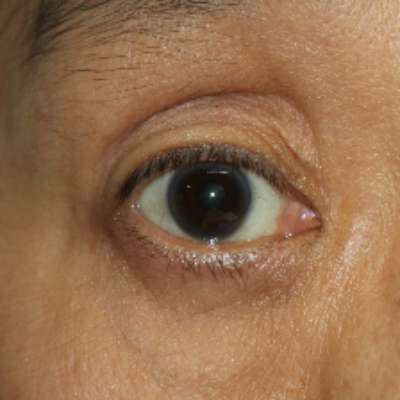

[ex,ey] = 1558,540 [ew,eh] = 771,771


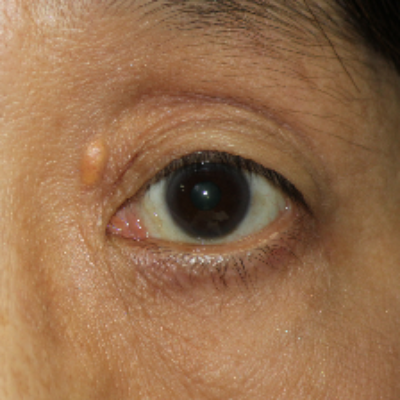

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/28.JPG
目が2個検出されました
[[ 235  658  772  772]
 [1464  652  783  783]]
[ex,ey] = 235,658 [ew,eh] = 772,772


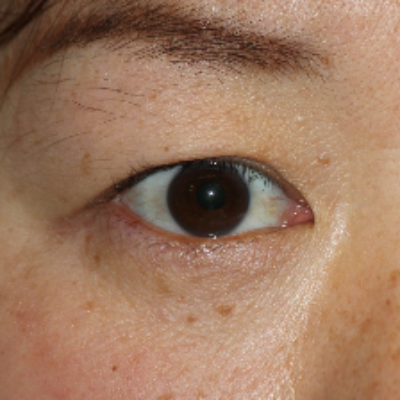

[ex,ey] = 1464,652 [ew,eh] = 783,783


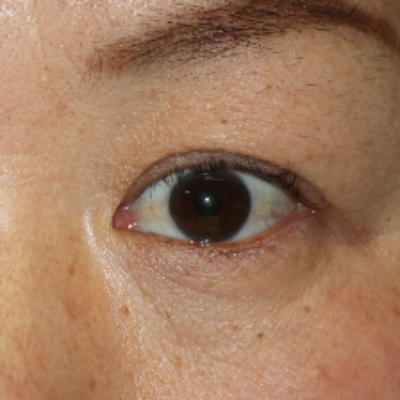

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/29.JPG
目が2個検出されました
[[  99  433  716  716]
 [1587  419  741  741]]
[ex,ey] = 99,433 [ew,eh] = 716,716


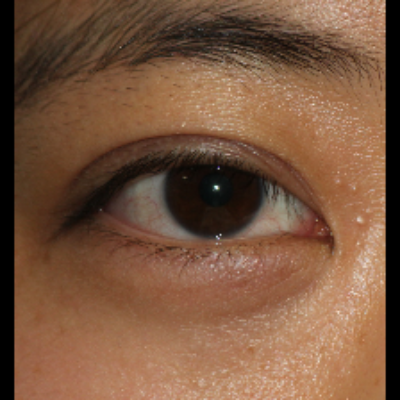

[ex,ey] = 1587,419 [ew,eh] = 741,741


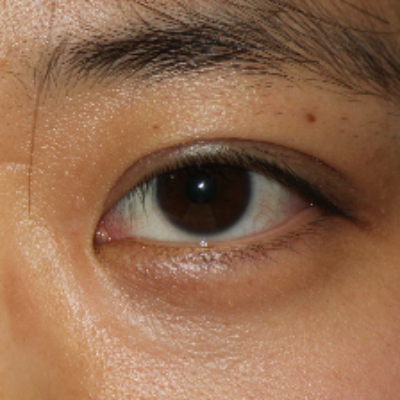

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/30.JPG
目が2個検出されました
[[1595  588  772  772]
 [ 152  518  853  853]]
[ex,ey] = 1595,588 [ew,eh] = 772,772


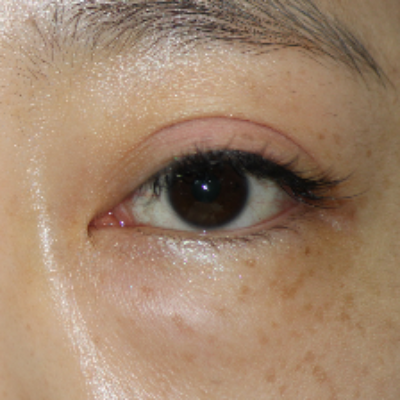

[ex,ey] = 152,518 [ew,eh] = 853,853
crop error
image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/31.JPG
目が2個検出されました
[[1543  660  681  681]
 [ 273  672  709  709]]
[ex,ey] = 1543,660 [ew,eh] = 681,681


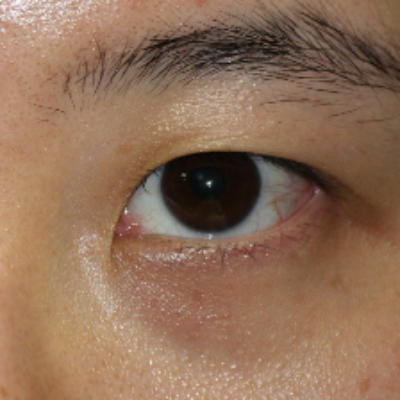

[ex,ey] = 273,672 [ew,eh] = 709,709


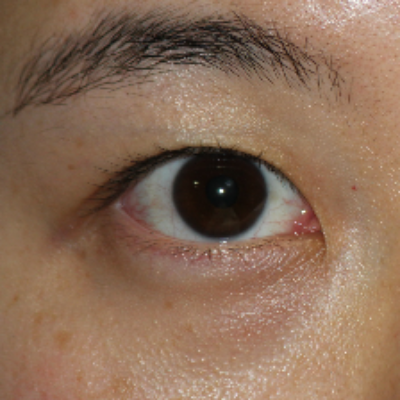

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/32.JPG
目が2個検出されました
[[1619  530  769  769]
 [ 156  584  698  698]]
[ex,ey] = 1619,530 [ew,eh] = 769,769


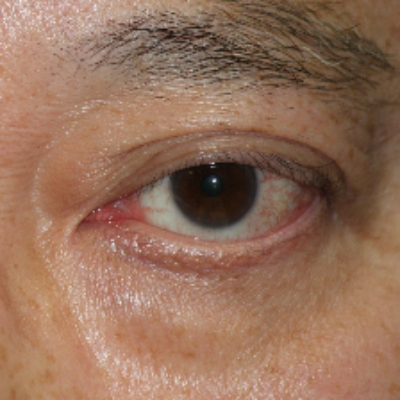

[ex,ey] = 156,584 [ew,eh] = 698,698


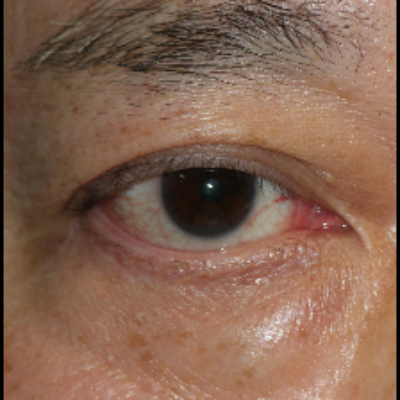

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/33.JPG
目が2個検出されました
[[ 172  511  804  804]
 [1621  600  780  780]]
[ex,ey] = 172,511 [ew,eh] = 804,804
crop error
[ex,ey] = 1621,600 [ew,eh] = 780,780


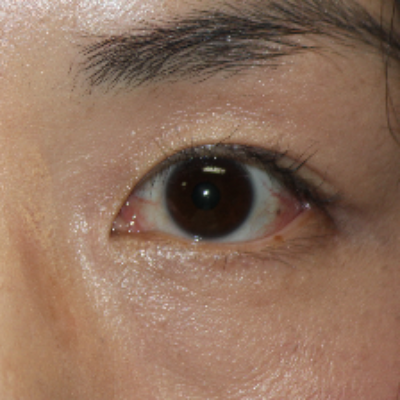

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/34.JPG
目が2個検出されました
[[ 136  578  746  746]
 [1634  621  738  738]]
[ex,ey] = 136,578 [ew,eh] = 746,746


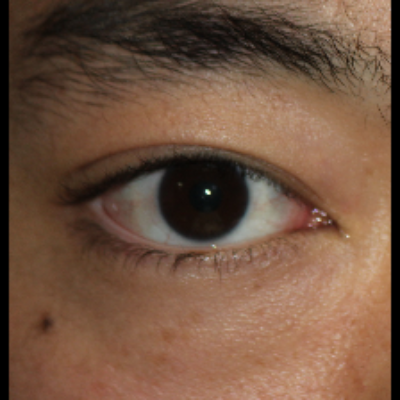

[ex,ey] = 1634,621 [ew,eh] = 738,738


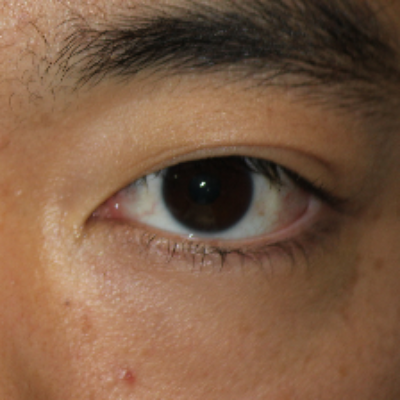

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/35.JPG
目が2個検出されました
[[1542  637  705  705]
 [ 256  622  737  737]]
[ex,ey] = 1542,637 [ew,eh] = 705,705


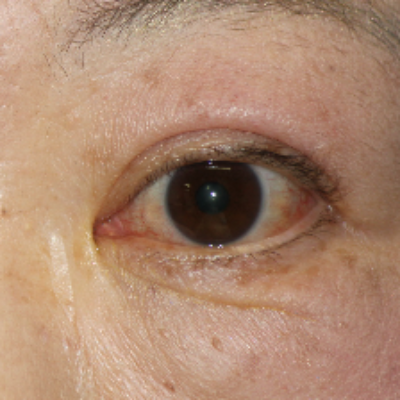

[ex,ey] = 256,622 [ew,eh] = 737,737


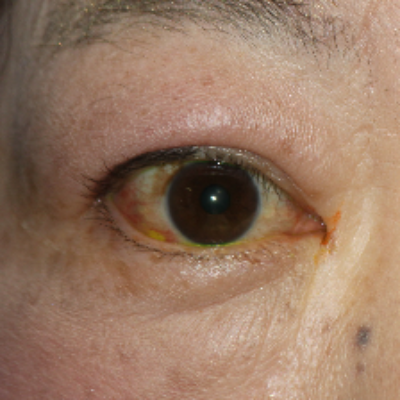

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/36.JPG
目が2個検出されました
[[1603  400  824  824]
 [ 132  444  814  814]]
[ex,ey] = 1603,400 [ew,eh] = 824,824
crop error
[ex,ey] = 132,444 [ew,eh] = 814,814
crop error
image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/37.JPG
目が2個検出されました
[[ 129  552  831  831]
 [1543  544  850  850]]
[ex,ey] = 129,552 [ew,eh] = 831,831


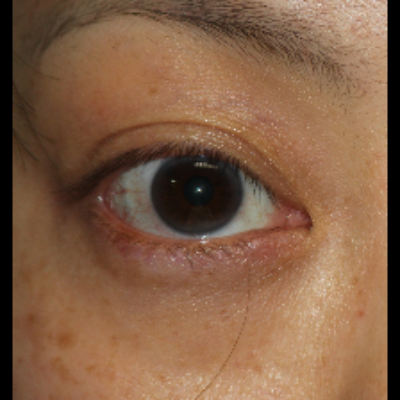

[ex,ey] = 1543,544 [ew,eh] = 850,850
crop error
image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/38.JPG
目が2個検出されました
[[1509  425  844  844]
 [ 137  441  765  765]]
[ex,ey] = 1509,425 [ew,eh] = 844,844


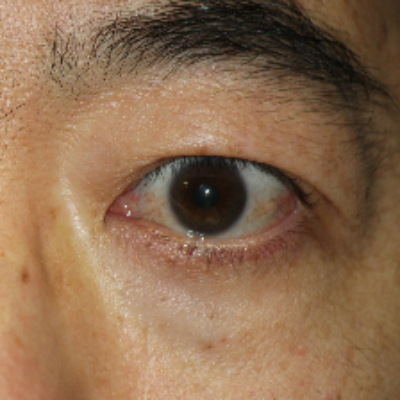

[ex,ey] = 137,441 [ew,eh] = 765,765


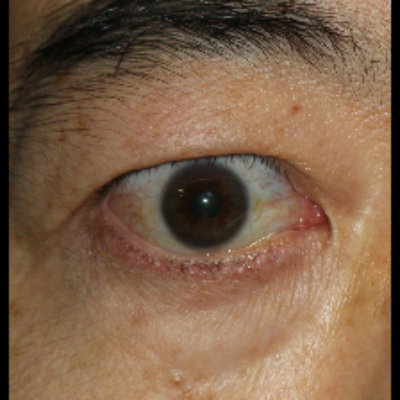

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/39.JPG
目が2個検出されました
[[1733  575  809  809]
 [  81  558  770  770]]
[ex,ey] = 1733,575 [ew,eh] = 809,809


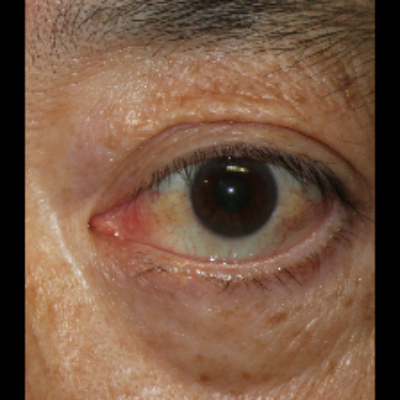

[ex,ey] = 81,558 [ew,eh] = 770,770
crop error
image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/40.JPG
目が2個検出されました
[[ 207  582  855  855]
 [1533  563  889  889]]
[ex,ey] = 207,582 [ew,eh] = 855,855


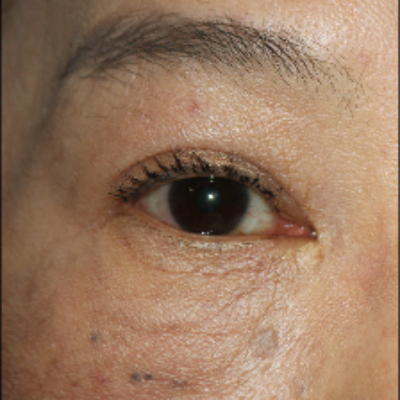

[ex,ey] = 1533,563 [ew,eh] = 889,889


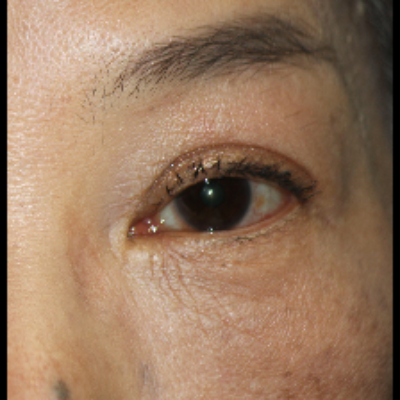

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/42.JPG
目が2個検出されました
[[ 134  485  843  843]
 [1695  509  800  800]]
[ex,ey] = 134,485 [ew,eh] = 843,843


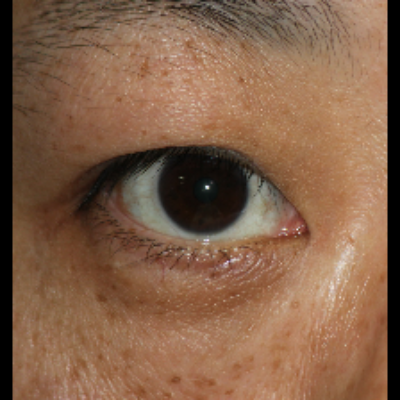

[ex,ey] = 1695,509 [ew,eh] = 800,800
crop error
image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/43.JPG
目が2個検出されました
[[ 232  529  699  699]
 [1539  494  837  837]]
[ex,ey] = 232,529 [ew,eh] = 699,699


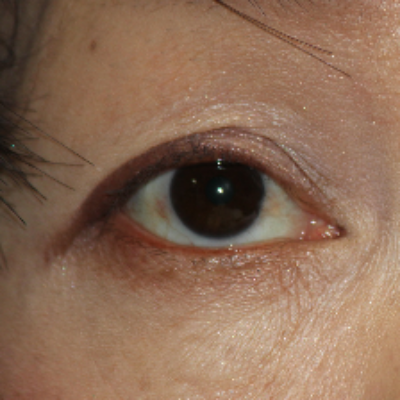

[ex,ey] = 1539,494 [ew,eh] = 837,837


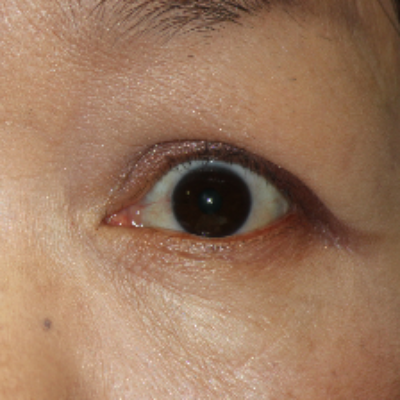

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/44.JPG
目が2個検出されました
[[1589  380  812  812]
 [ 135  485  700  700]]
[ex,ey] = 1589,380 [ew,eh] = 812,812


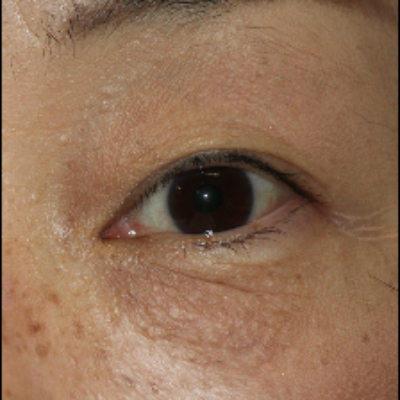

[ex,ey] = 135,485 [ew,eh] = 700,700


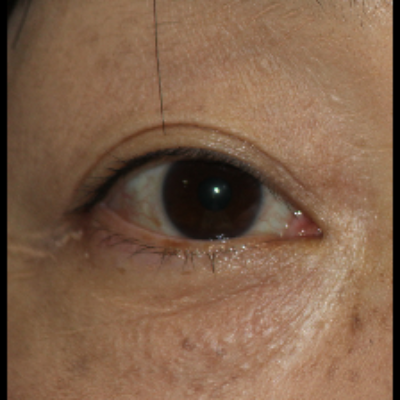

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/41.JPG
目が2個検出されました
[[ 187  671  733  733]
 [1533  689  739  739]]
[ex,ey] = 187,671 [ew,eh] = 733,733


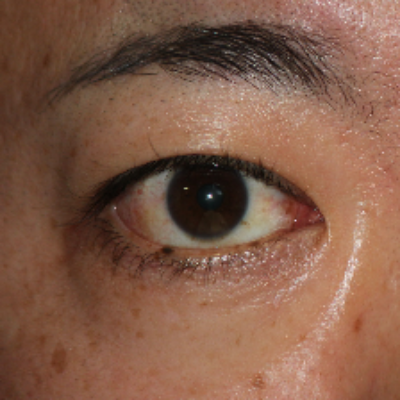

[ex,ey] = 1533,689 [ew,eh] = 739,739


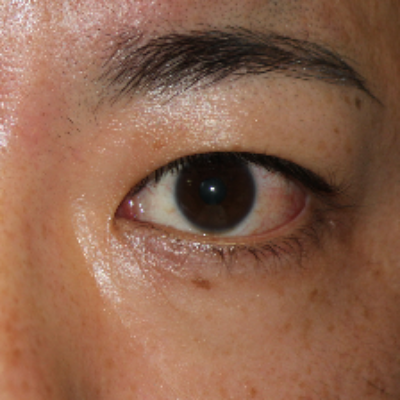

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/45.JPG
目が2個検出されました
[[1643  496  710  710]
 [ 181  510  741  741]]
[ex,ey] = 1643,496 [ew,eh] = 710,710


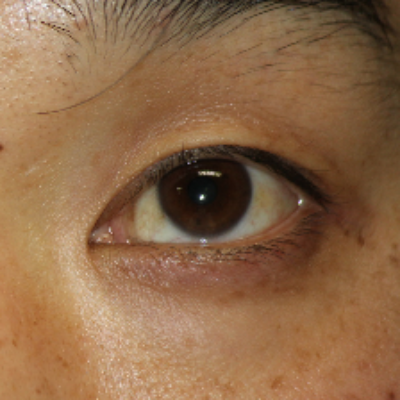

[ex,ey] = 181,510 [ew,eh] = 741,741


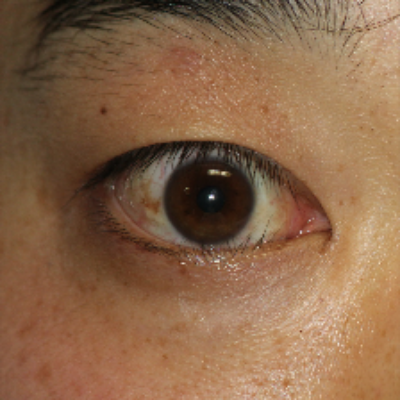

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/47.JPG
目が2個検出されました
[[ 194  432  810  810]
 [1496  387  867  867]]
[ex,ey] = 194,432 [ew,eh] = 810,810


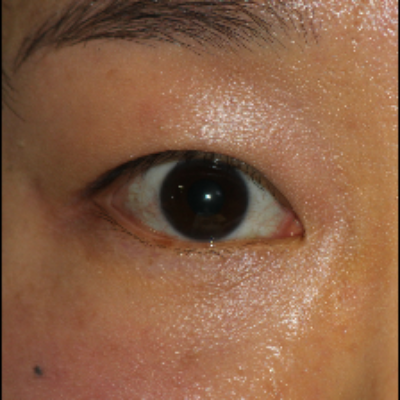

[ex,ey] = 1496,387 [ew,eh] = 867,867


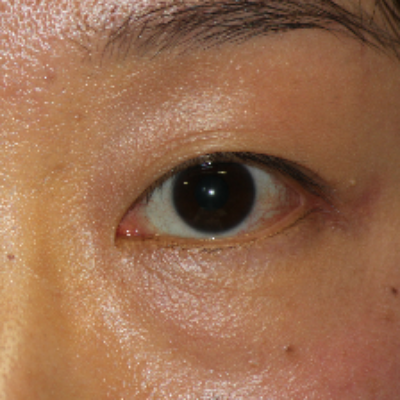

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/46.JPG
目が2個検出されました
[[ 169  598  790  790]
 [1609  562  848  848]]
[ex,ey] = 169,598 [ew,eh] = 790,790


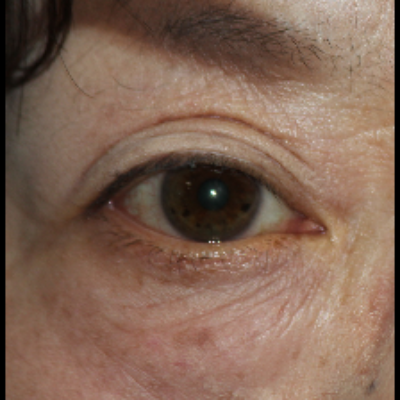

[ex,ey] = 1609,562 [ew,eh] = 848,848
crop error
image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/48.JPG
目が2個検出されました
[[ 114  496  891  891]
 [1550  501  891  891]]
[ex,ey] = 114,496 [ew,eh] = 891,891


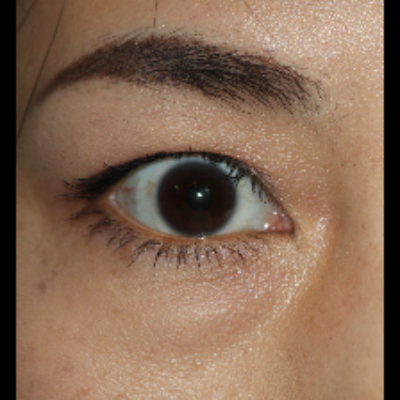

[ex,ey] = 1550,501 [ew,eh] = 891,891
crop error
image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/49.JPG
目が2個検出されました
[[1575  538  849  849]
 [ 170  544  784  784]]
[ex,ey] = 1575,538 [ew,eh] = 849,849


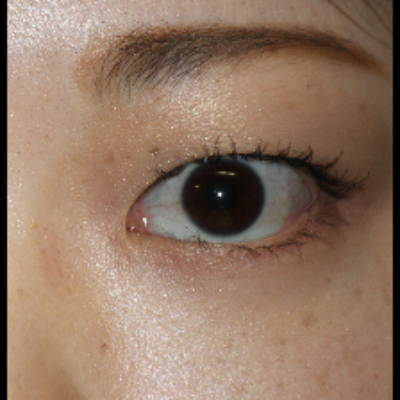

[ex,ey] = 170,544 [ew,eh] = 784,784


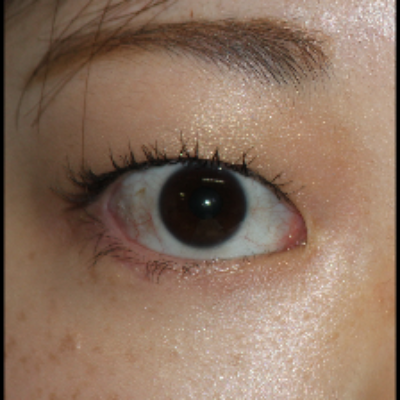

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/50.JPG
目が2個検出されました
[[ 137  490  905  905]
 [1571  498  769  769]]
[ex,ey] = 137,490 [ew,eh] = 905,905
crop error
[ex,ey] = 1571,498 [ew,eh] = 769,769


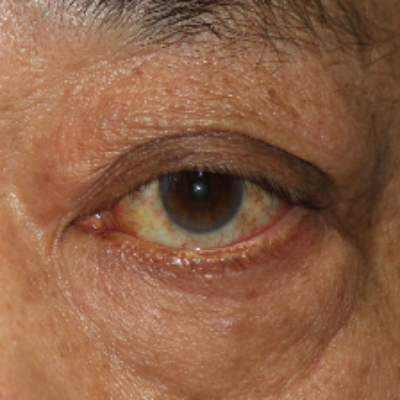

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/51.JPG
目が1個検出されました
[[204 540 756 756]]
[ex,ey] = 204,540 [ew,eh] = 756,756


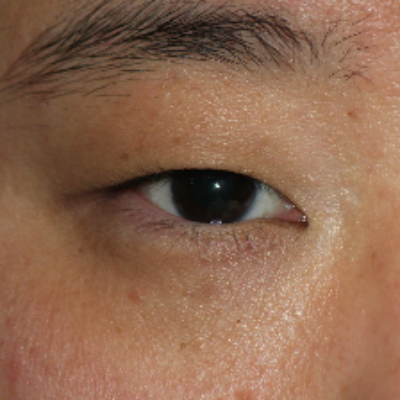

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/52.JPG
目が2個検出されました
[[ 181  614  713  713]
 [1617  580  790  790]]
[ex,ey] = 181,614 [ew,eh] = 713,713


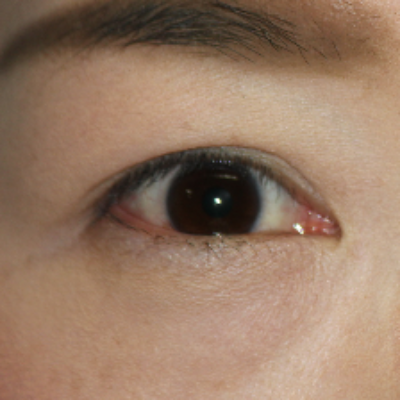

[ex,ey] = 1617,580 [ew,eh] = 790,790


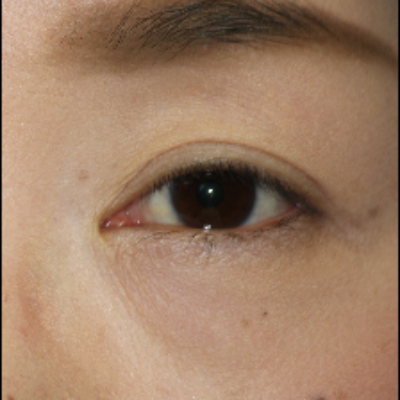

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/53.JPG
目が2個検出されました
[[ 122  572  752  752]
 [1542  551  832  832]]
[ex,ey] = 122,572 [ew,eh] = 752,752


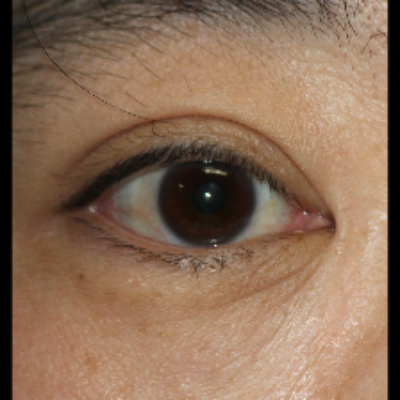

[ex,ey] = 1542,551 [ew,eh] = 832,832


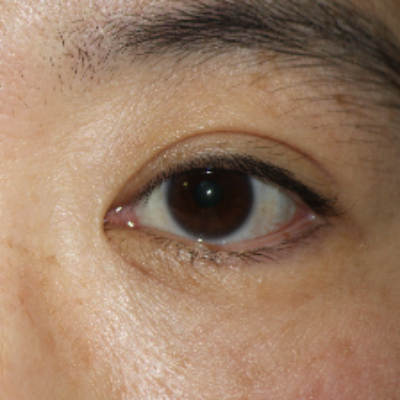

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/54.JPG
目が2個検出されました
[[ 158  494  849  849]
 [1467  494  904  904]]
[ex,ey] = 158,494 [ew,eh] = 849,849


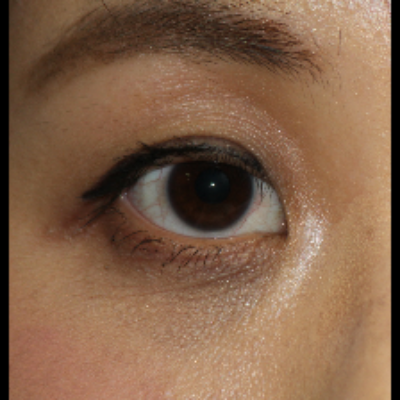

[ex,ey] = 1467,494 [ew,eh] = 904,904
crop error
image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/55.JPG
目が2個検出されました
[[ 113  493  831  831]
 [1556  558  834  834]]
[ex,ey] = 113,493 [ew,eh] = 831,831


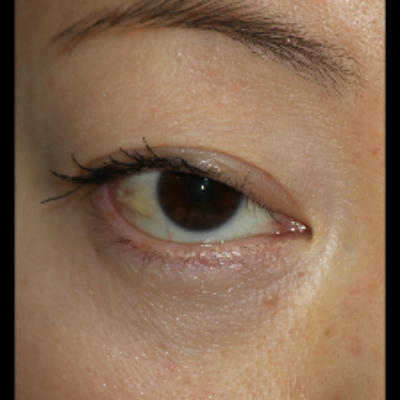

[ex,ey] = 1556,558 [ew,eh] = 834,834


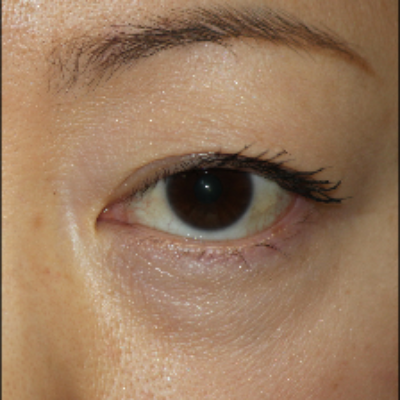

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/56.JPG
目が2個検出されました
[[1593  499  831  831]
 [ 182  509  815  815]]
[ex,ey] = 1593,499 [ew,eh] = 831,831
crop error
[ex,ey] = 182,509 [ew,eh] = 815,815
crop error
image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/57.JPG
目が2個検出されました
[[ 255  430  736  736]
 [1692  502  727  727]]
[ex,ey] = 255,430 [ew,eh] = 736,736


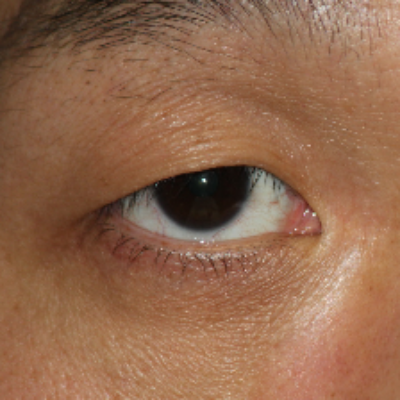

[ex,ey] = 1692,502 [ew,eh] = 727,727


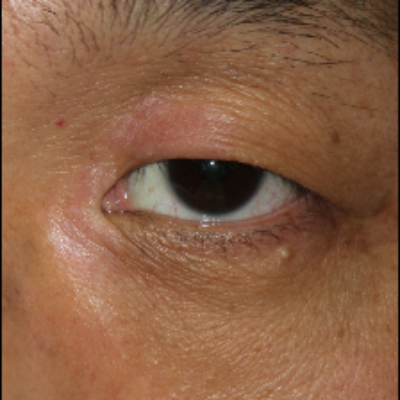

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/59.JPG
目が1個検出されました
[[171 542 781 781]]
[ex,ey] = 171,542 [ew,eh] = 781,781


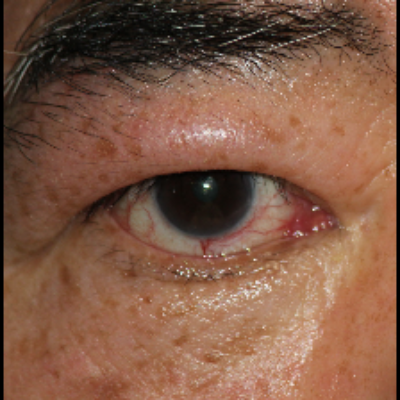

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/58.JPG
目が1個検出されました
[[111 486 796 796]]
[ex,ey] = 111,486 [ew,eh] = 796,796


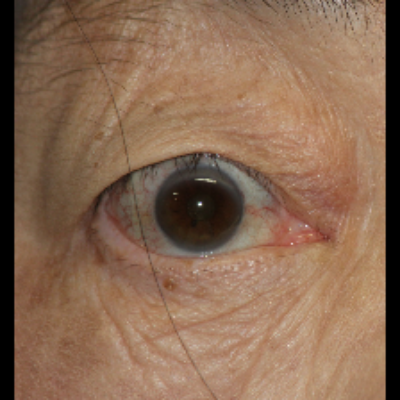

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/60.JPG
目が2個検出されました
[[ 177  464  766  766]
 [1566  470  834  834]]
[ex,ey] = 177,464 [ew,eh] = 766,766


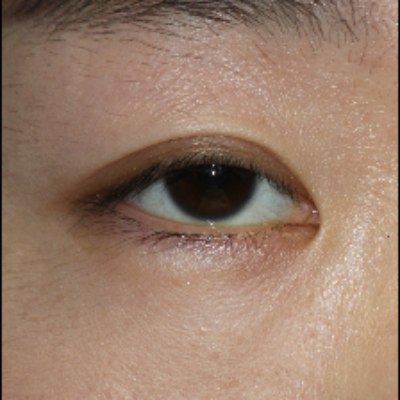

[ex,ey] = 1566,470 [ew,eh] = 834,834


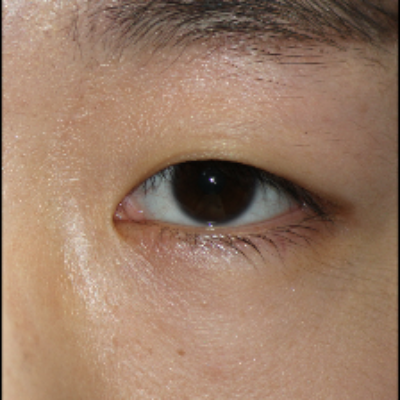

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/61.JPG
目が2個検出されました
[[1550  457  794  794]
 [ 146  503  726  726]]
[ex,ey] = 1550,457 [ew,eh] = 794,794


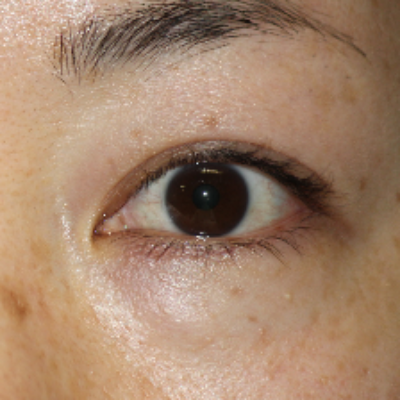

[ex,ey] = 146,503 [ew,eh] = 726,726
crop error
image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/62.JPG
目が2個検出されました
[[1571  602  795  795]
 [ 238  515  809  809]]
[ex,ey] = 1571,602 [ew,eh] = 795,795


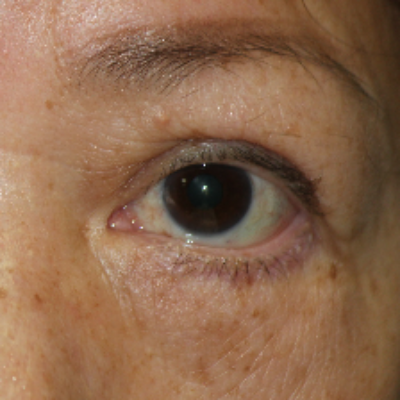

[ex,ey] = 238,515 [ew,eh] = 809,809


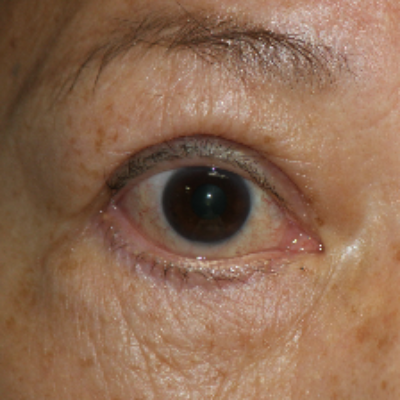

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/63.JPG
目が2個検出されました
[[ 147  549  815  815]
 [1406  560  783  783]]
[ex,ey] = 147,549 [ew,eh] = 815,815


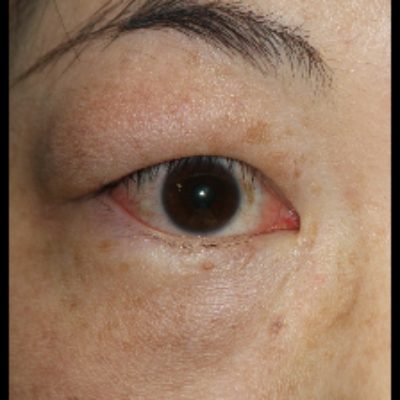

[ex,ey] = 1406,560 [ew,eh] = 783,783


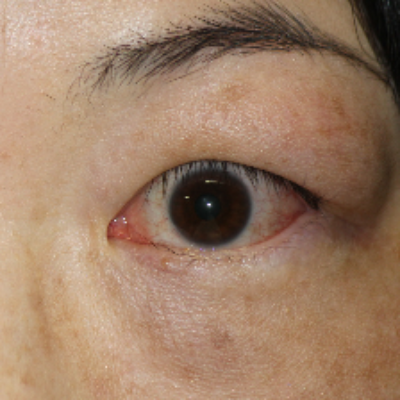

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/64.JPG
目が2個検出されました
[[ 173  692  665  665]
 [1609  707  771  771]]
[ex,ey] = 173,692 [ew,eh] = 665,665


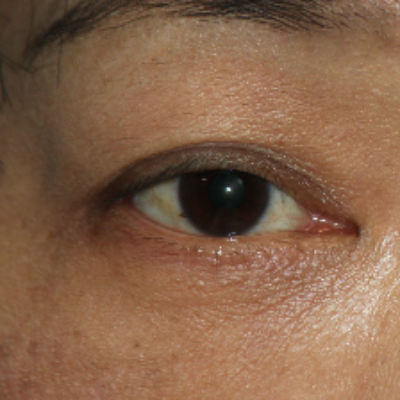

[ex,ey] = 1609,707 [ew,eh] = 771,771


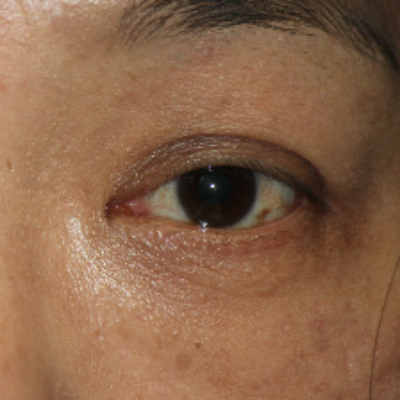

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/65.JPG
目が2個検出されました
[[  75  575  764  764]
 [1577  580  779  779]]
[ex,ey] = 75,575 [ew,eh] = 764,764


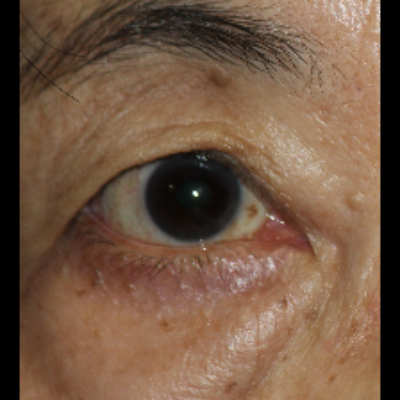

[ex,ey] = 1577,580 [ew,eh] = 779,779


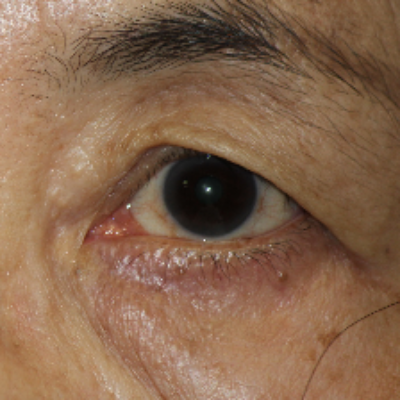

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/66.JPG
目が2個検出されました
[[1568  586  791  791]
 [ 149  581  775  775]]
[ex,ey] = 1568,586 [ew,eh] = 791,791


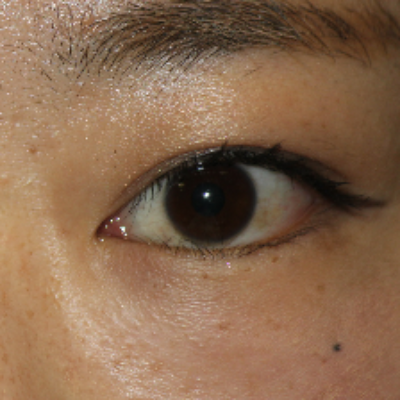

[ex,ey] = 149,581 [ew,eh] = 775,775


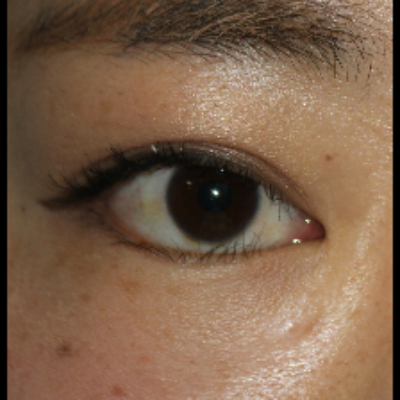

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/67.JPG
目が2個検出されました
[[ 183  555  788  788]
 [1556  585  796  796]]
[ex,ey] = 183,555 [ew,eh] = 788,788


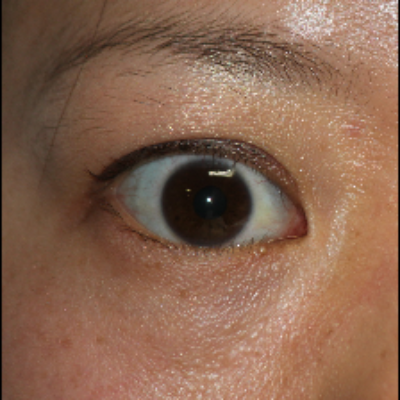

[ex,ey] = 1556,585 [ew,eh] = 796,796


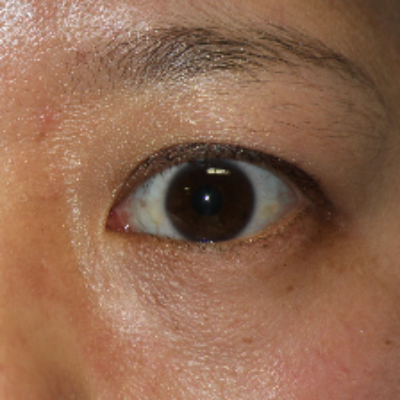

image path =  /content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset/68.JPG
目が2個検出されました
[[ 244  502  800  800]
 [1618  494  832  832]]
[ex,ey] = 244,502 [ew,eh] = 800,800


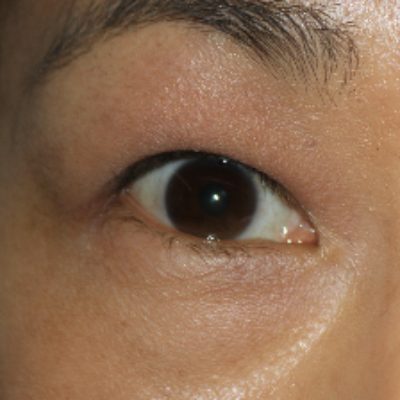

In [ ]:
orig_folder = "/content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset" #olympiaのデータセット
dst_folder = "/content/drive/MyDrive/Deep_learning/Olympia_dataset/dataset_224px_uni_periocular"


#処理時間の計測
start = time.time()

#もしdst_folderがあれば削除して新しく作り直す
if os.path.exists(dst_folder):
    shutil.rmtree(dst_folder)
os.makedirs(dst_folder)

path_list = glob.glob(orig_folder+"/*")

for path in path_list:
    img_resized_list, side_list = crop_bilateral(path, 224) #両眼抜き出して224pxで保存（crop時にエラーが出るものは削除される）
    for img, side in zip(img_resized_list, side_list):
        if side == 0:
            sidestr = "R"
        elif side == 1:
            sidestr = "L"
        cv2.imwrite(dst_folder +"/"+ os.path.basename(path).split(".")[0]+"_"+sidestr+".JPG", img)

print('Process done!!')
elapsed_time = time.time() - start
print ("elapsed_time:{0}".format(elapsed_time) + "[sec]")
